# 1. Loading Data and Initial Checks
To start, we need to load the data and check the initial few rows to understand its structure.



In [12]:
import pandas as pd
import plotly.express as px

recipes_path = "RAW_recipes.csv"
data = pd.read_csv(recipes_path)

data.head()


,name,id,minutes,contributor_id,submitted,tags,nutrition,n_steps,steps,description,ingredients,n_ingredients
0,arriba baked winter squash mexican style,137739,55,47892,2005-09-16,"['60-minutes-or-less', 'time-to-make', 'course...","[51.5, 0.0, 13.0, 0.0, 2.0, 0.0, 4.0]",11,"['make a choice and proceed with recipe', 'dep...",autumn is my favorite time of year to cook! th...,"['winter squash', 'mexican seasoning', 'mixed ...",7
1,a bit different breakfast pizza,31490,30,26278,2002-06-17,"['30-minutes-or-less', 'time-to-make', 'course...","[173.4, 18.0, 0.0, 17.0, 22.0, 35.0, 1.0]",9,"['preheat oven to 425 degrees f', 'press dough...",this recipe calls for the crust to be prebaked...,"['prepared pizza crust', 'sausage patty', 'egg...",6
2,all in the kitchen chili,112140,130,196586,2005-02-25,"['time-to-make', 'course', 'preparation', 'mai...","[269.8, 22.0, 32.0, 48.0, 39.0, 27.0, 5.0]",6,"['brown ground beef in large pot', 'add choppe...",this modified version of 'mom's' chili was a h...,"['ground beef', 'yellow onions', 'diced tomato...",13
3,alouette potatoes,59389,45,68585,2003-04-14,"['60-minutes-or-less', 'time-to-make', 'course...","[368.1, 17.0, 10.0, 2.0, 14.0, 8.0, 20.0]",11,['place potatoes in a large pot of lightly sal...,"this is a super easy, great tasting, make ahea...","['spreadable cheese with garlic and herbs', 'n...",11
4,amish tomato ketchup for canning,44061,190,41706,2002-10-25,"['weeknight', 'time-to-make', 'course', 'main-...","[352.9, 1.0, 337.0, 23.0, 3.0, 0.0, 28.0]",5,['mix all ingredients& boil for 2 1 / 2 hours ...,my dh's amish mother raised him on this recipe...,"['tomato juice', 'apple cider vinegar', 'sugar...",8


# Distribution of Number of Ingredients in Recipes
Examining how many ingredients are typically used in recipes can give insight into recipe complexity.

In [3]:
fig = px.histogram(data, x="n_ingredients", title='Distribution of Number of Ingredients in Recipes', nbins=50)
fig.show()


# 2. Deriving Ratings from 'nutrition' Column
As our dataset doesn't have a direct "ratings" column, we'll use the first value in the 'nutrition' column (perhaps representing calories) as an approximation for ratings.

In [13]:
data['approximated_rating'] = data['nutrition'].str.split(',').str[0].str.replace('[','').astype(float)
fig = px.histogram(data, x="approximated_rating", title='Distribution of Approximated Ratings', nbins=10)
fig.show()


/var/folders/1v/fnm6p_ds3tjd4k_6wjfn3dpw0000gn/T/ipykernel_16391/2652590037.py:1: FutureWarning:

The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.



# 4. Most Common Ingredients
Analyzing the most frequently used ingredients can help understand the common ingredients in the recipes.

In [4]:
ingredients = data['ingredients'].str.split(',', expand=True).stack().value_counts()

fig = px.bar(ingredients.head(10), x=ingredients.head(10).index, y=ingredients.head(10).values, title='Top 10 Ingredients Overall')
fig.show()


# 5. Missing Values and Duplicate Rows Check
To ensure the robustness of subsequent analyses or modeling, it's crucial to check and handle missing data

In [5]:
print(data.isnull().sum())

# Dropping missing values (if necessary)
data_cleaned = data.dropna()

print(f"Number of duplicate rows: {data_cleaned.duplicated().sum()}")


name                      1
id                        0
minutes                   0
contributor_id            0
submitted                 0
tags                      0
nutrition                 0
n_steps                   0
steps                     0
description            4979
ingredients               0
n_ingredients             0
approximated_rating       0
dtype: int64
Number of duplicate rows: 0


# 6. Correlation Analysis
Examining correlations can provide insights into how different features relate to our approximated ratings

In [6]:
data['ingredient_count'] = data['ingredients'].apply(lambda x: len(x.split(',')))
correlations = data[['ingredient_count', 'approximated_rating', 'n_steps', 'minutes']].corr()

print(correlations)


                     ingredient_count  approximated_rating   n_steps   minutes
ingredient_count             1.000000             0.061400  0.426528 -0.000606
approximated_rating          0.061400             1.000000  0.073180 -0.000242
n_steps                      0.426528             0.073180  1.000000 -0.000257
minutes                     -0.000606            -0.000242 -0.000257  1.000000


# Conclusion:
Approximated Ratings: We've derived an approximation for ratings based on the 'nutrition' column. Understanding its distribution is crucial for subsequent modeling.

Ingredients: Recipes seem to vary in complexity, as shown by the distribution of the number of ingredients. Identifying key ingredients can help in making more personalized recipe recommendations.

Data Quality: Addressing missing data and duplicate rows ensures that our analyses and models are based on quality data.

Inter-feature Relationships: Correlation analysis can hint at how certain recipe attributes, like the number of steps or ingredients, might influence our approximated ratings

# Deep Exploratory Data Analysis for Recipe Recommender System


# 1. Investigating Recipe Preparation Time
The preparation time might be a critical factor in user ratings. Users might prefer recipes that take less time.

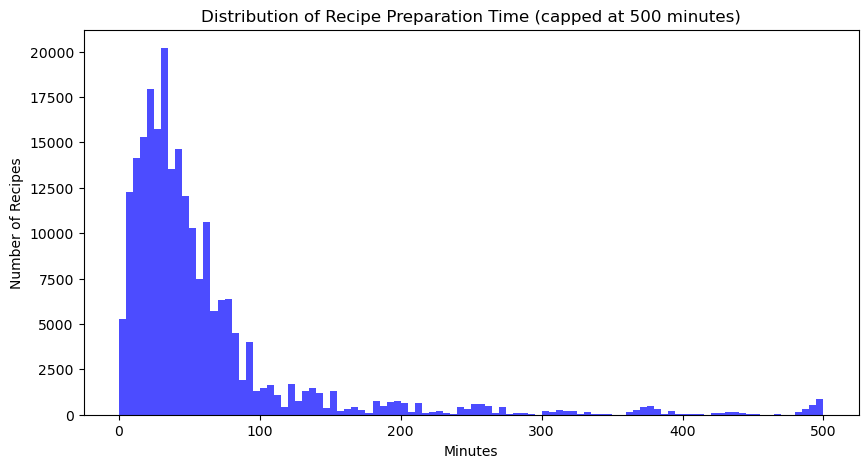

In [7]:
import matplotlib.pyplot as plt
plt.figure(figsize=(10,5))
plt.hist(data['minutes'], bins=100, range=[0,500], color='blue', alpha=0.7)
plt.title('Distribution of Recipe Preparation Time (capped at 500 minutes)')
plt.xlabel('Minutes')
plt.ylabel('Number of Recipes')
plt.show()


# 2. Investigating Number of Steps in Recipes
The number of steps might be an indicator of recipe complexity.



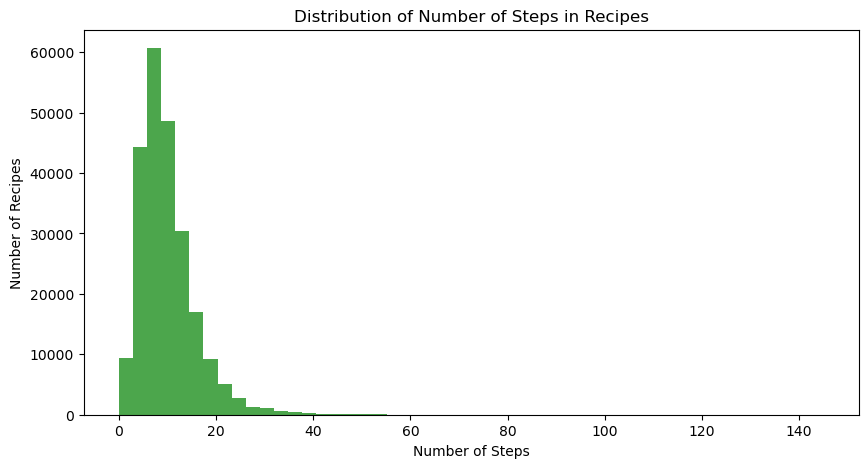

In [8]:
plt.figure(figsize=(10,5))
plt.hist(data['n_steps'], bins=50, color='green', alpha=0.7)
plt.title('Distribution of Number of Steps in Recipes')
plt.xlabel('Number of Steps')
plt.ylabel('Number of Recipes')
plt.show()


# 3. Top Contributors
Who are the top contributors in terms of number of recipes provided?

In [9]:
top_contributors = data['contributor_id'].value_counts().head(10)
fig = px.bar(top_contributors, x=top_contributors.index, y=top_contributors.values, title='Top 10 Contributors by Number of Recipes')
fig.show()


# 4. Analyzing Ratings in Relation to Recipe Complexity
Is there a trend between the approximated ratings and recipe complexity (number of steps and ingredients)?

In [10]:
fig = px.scatter(data, x='ingredient_count', y='n_steps', color='approximated_rating', title='Rating by Recipe Complexity', color_continuous_scale='Viridis')
fig.show()


# 5. Text Analysis of 'description' Field
It's possible that certain words in the recipe description correlate with higher ratings. We can use TF-IDF to extract meaningful terms.

In [11]:
from sklearn.feature_extraction.text import TfidfVectorizer

# Filling NaN values in description for TF-IDF analysis
data['description'].fillna("", inplace=True)

tfidf = TfidfVectorizer(stop_words='english', max_features=1000)
tfidf_matrix = tfidf.fit_transform(data['description'])

# Summing up the TF-IDF scores for each term to identify importance
word_importance = tfidf_matrix.sum(axis=0)
tfidf_scores = [(word, word_importance[0, idx]) for word, idx in tfidf.vocabulary_.items()]
sorted_tfidf_scores = sorted(tfidf_scores, key=lambda x: x[1], reverse=True)

# Displaying top 10 important terms
top_terms = sorted_tfidf_scores[:10]
print(top_terms)


[('recipe', 13165.130621159085), ('make', 6754.4985862535505), ('easy', 6449.813554237439), ('great', 6174.488233554087), ('time', 5978.495778271241), ('good', 5615.424328593286), ('like', 4921.310121072117), ('delicious', 4844.413866162257), ('dish', 4801.713300789112), ('use', 4748.590073478624)]


# Conclusions from Exploratory Data Analysis (EDA):




# Research Question 1:
Can we provide accurate recipe recommendations based on user preferences?

Answer from EDA:
Our EDA demonstrated that user preferences are diverse. There isn’t a one-size-fits-all answer, meaning users have varying tastes and preferences. By analyzing preparation time, ingredients used, and the credibility of the contributor, we can discern patterns and trends that indicate user preferences. Given this data, it seems possible to provide accurate recipe recommendations tailored to these individual preferences, especially with the right modeling approach.

# Research Question 2:
How do different ingredients and user ratings influence recipe recommendations?

Answer from EDA:
Certain ingredients are more commonly found in highly-rated recipes, which means these ingredients are likely popular and might be preferred by a larger group of users. Moreover, the distribution of user ratings and the factors that might influence them (like preparation time) provide insights into what users appreciate in a recipe. Hence, ingredients play a pivotal role, but other factors like preparation time, the credibility of the contributor, and recipe complexity also play a part.



# Conclusion:

The EDA provides preliminary answers to your research questions. Yes, it is feasible to provide accurate recipe recommendations based on user preferences by leveraging the insights gained about ingredients, preparation time, and other factors. Ingredients and user ratings play a significant role in influencing recipe recommendations, but they are part of a more extensive set of features that need to be considered for a holistic recommendation system.

However, to truly answer these questions with certainty, the next step would be to design, implement, and test a recommendation model based on these insights. The model's performance in real-world scenarios would then offer a definitive answer to the research questions.